### ADDITIONAL PREPROCESSING

In [53]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import *
import plotly.express as pe

In [2]:
import warnings
warnings.filterwarnings('ignore')

In [68]:
train_data = pd.read_csv('Final_Train_Dataset.csv')
test_data = pd.read_csv('Final_Test_Dataset.csv')
train_data_emb = pd.read_csv('train_data_embedded.csv')
test_data_emb = pd.read_csv('test_data_embedded.csv')

In [69]:
train_data_emb

,1,2,3,4,5,6,7,8,9,10,...,503,504,505,506,507,508,509,510,511,512
0,-0.0301,0.0001,-0.0190,-0.0317,0.0344,-0.0757,-0.0199,0.0441,-0.0144,0.0199,...,0.0416,0.0657,-0.0185,-0.0479,0.0653,-0.0754,-0.0089,-0.0270,0.0208,0.0030
1,0.0064,0.0323,-0.0053,0.0254,0.0423,-0.0634,-0.0155,0.0681,-0.0061,-0.0254,...,-0.0239,0.0709,-0.0224,-0.0131,-0.0446,-0.0681,0.0154,-0.0531,0.0428,-0.0257
2,0.0382,0.0345,-0.0073,-0.0062,-0.0440,-0.0388,-0.0083,0.0453,-0.0249,-0.0538,...,0.0468,0.0610,0.0499,-0.0345,0.0667,-0.0671,0.0200,-0.0532,0.0222,0.0199
3,-0.0165,-0.0385,-0.0390,-0.0072,-0.0277,-0.0576,0.0253,0.0177,0.0103,0.0526,...,-0.0312,0.0562,0.0448,0.0007,-0.0036,-0.0582,0.0181,0.0134,-0.0369,0.0463
4,0.0493,0.0539,-0.0169,-0.0027,-0.0587,-0.0330,0.0579,0.0585,0.0381,0.0434,...,-0.0118,0.0613,0.0616,-0.0303,0.0505,-0.0616,0.0264,-0.0591,-0.0094,-0.0509
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19797,-0.0081,0.0551,-0.0136,0.0437,0.0408,-0.0528,-0.0314,-0.0101,-0.0447,0.0389,...,0.0614,0.0636,-0.0318,-0.0187,0.0560,-0.0660,0.0354,-0.0214,-0.0322,0.0178
19798,-0.0226,0.0426,-0.0115,0.0092,0.0353,-0.0337,0.0262,0.0012,-0.0071,-0.0414,...,0.0282,0.0727,0.0635,-0.0012,0.0299,-0.0686,0.0337,-0.0146,-0.0612,0.0286
19799,0.0155,0.0498,-0.0107,0.0073,-0.0507,-0.0134,0.0565,0.0448,-0.0381,-0.0449,...,-0.0225,0.0571,0.0566,0.0063,0.0346,-0.0585,0.0438,-0.0454,-0.0532,0.0583
19800,0.0338,0.0260,-0.0039,-0.0152,-0.0625,-0.0228,0.0676,0.0679,-0.0012,0.0035,...,-0.0655,0.0677,0.0621,0.0022,0.0612,-0.0433,0.0269,-0.0522,-0.0431,-0.0432


In [70]:
test_data_emb

,1,2,3,4,5,6,7,8,9,10,...,503,504,505,506,507,508,509,510,511,512
0,-0.0399,-0.0406,-0.0317,0.0551,0.0348,-0.0562,0.0066,0.0265,-0.0566,-0.0533,...,-0.0496,0.0417,0.0518,0.0071,0.0503,-0.0575,0.0302,0.0356,-0.0431,0.0574
1,-0.0158,0.0499,-0.0184,-0.0093,-0.0169,-0.0310,0.0469,0.0105,0.0026,0.0481,...,0.0225,0.0571,0.0565,-0.0295,0.0640,-0.0631,0.0263,-0.0617,-0.0383,0.0349
2,0.0614,0.0602,0.0341,-0.0094,-0.0178,-0.0101,-0.0216,0.0573,-0.0012,-0.0084,...,-0.0363,0.0590,0.0640,-0.0203,-0.0448,-0.0613,0.0399,-0.0430,-0.0170,0.0467
3,-0.0201,0.0438,-0.0102,0.0146,0.0402,-0.0381,0.0181,-0.0014,-0.0072,-0.0454,...,0.0298,0.0734,0.0590,-0.0020,0.0244,-0.0690,0.0347,0.0132,-0.0636,0.0317
4,-0.0223,-0.0207,-0.0284,-0.0137,0.0033,-0.0521,0.0061,0.0472,0.0030,-0.0383,...,0.0338,0.0516,0.0488,-0.0597,0.0538,-0.0631,0.0134,-0.0418,-0.0222,-0.0008
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6596,-0.0130,-0.0588,0.0088,0.0295,0.0164,-0.0616,0.0232,0.0019,-0.0172,0.0006,...,-0.0204,0.0592,0.0393,0.0153,-0.0001,-0.0637,0.0236,-0.0355,-0.0092,0.0154
6597,0.0131,-0.0231,-0.0110,0.0456,0.0082,-0.0571,0.0413,0.0030,-0.0174,-0.0557,...,0.0215,0.0605,0.0516,-0.0085,0.0341,-0.0620,0.0474,-0.0384,-0.0404,0.0371
6598,0.0385,-0.0316,0.0067,0.0568,0.0308,-0.0629,-0.0379,-0.0446,-0.0036,0.0064,...,0.0019,0.0630,0.0661,0.0135,-0.0257,-0.0641,0.0182,-0.0494,0.0057,0.0461
6599,0.0156,0.0537,-0.0127,0.0568,0.0423,-0.0555,-0.0241,0.0436,-0.0131,0.0658,...,0.0391,0.0645,0.0496,-0.0454,0.0628,-0.0659,-0.0230,-0.0265,0.0173,-0.0637


In [71]:
train_data.columns

Index(['Unnamed: 0', 'experience', 'job_description', 'job_desig', 'job_type',
       'key_skills', 'location', 'salary', 'company_name_encoded'],
      dtype='object')

In [72]:
### Drop location as salary varies from company to company

In [73]:
train_data = train_data.drop(columns=['Unnamed: 0','job_description', 'job_desig', 'job_type','key_skills','location'])
test_data = test_data.drop(columns=['job_description', 'job_desig', 'job_type','key_skills','location'])

In [74]:
train_data_exp = pd.get_dummies(train_data.experience)
test_data_exp = pd.get_dummies(test_data.experience)

In [75]:
train_data = train_data.join(train_data_exp.reset_index().set_index('index'))
test_data = test_data.join(test_data_exp.reset_index().set_index('index'))

In [76]:
train_data_emb = train_data_emb.join(train_data.reset_index().set_index('index')).drop(columns=['experience'])
test_data_emb = test_data_emb.join(test_data.reset_index().set_index('index')).drop(columns=['experience'])

In [77]:
le = LabelEncoder()
le.fit(train_data_emb['salary'])
le.classes_

array(['0to3', '10to15', '15to25', '25to50', '3to6', '6to10'],
      dtype=object)

In [78]:
train_data_emb['salary'] = LabelEncoder().fit_transform(train_data_emb['salary'])

In [79]:
train_data_emb

,1,2,3,4,5,6,7,8,9,10,...,8-11 yrs,8-12 yrs,8-13 yrs,8-8 yrs,8-9 yrs,9-10 yrs,9-11 yrs,9-12 yrs,9-13 yrs,9-14 yrs
0,-0.0301,0.0001,-0.0190,-0.0317,0.0344,-0.0757,-0.0199,0.0441,-0.0144,0.0199,...,0,0,0,0,0,0,0,0,0,0
1,0.0064,0.0323,-0.0053,0.0254,0.0423,-0.0634,-0.0155,0.0681,-0.0061,-0.0254,...,0,0,0,0,0,0,0,0,0,0
2,0.0382,0.0345,-0.0073,-0.0062,-0.0440,-0.0388,-0.0083,0.0453,-0.0249,-0.0538,...,0,0,0,0,0,0,0,0,0,0
3,-0.0165,-0.0385,-0.0390,-0.0072,-0.0277,-0.0576,0.0253,0.0177,0.0103,0.0526,...,0,0,0,0,0,0,0,0,0,0
4,0.0493,0.0539,-0.0169,-0.0027,-0.0587,-0.0330,0.0579,0.0585,0.0381,0.0434,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19797,-0.0081,0.0551,-0.0136,0.0437,0.0408,-0.0528,-0.0314,-0.0101,-0.0447,0.0389,...,0,0,0,0,0,0,0,0,0,0
19798,-0.0226,0.0426,-0.0115,0.0092,0.0353,-0.0337,0.0262,0.0012,-0.0071,-0.0414,...,0,0,0,0,0,0,0,0,0,0
19799,0.0155,0.0498,-0.0107,0.0073,-0.0507,-0.0134,0.0565,0.0448,-0.0381,-0.0449,...,0,0,1,0,0,0,0,0,0,0
19800,0.0338,0.0260,-0.0039,-0.0152,-0.0625,-0.0228,0.0676,0.0679,-0.0012,0.0035,...,0,0,0,0,0,0,0,0,0,0


In [80]:
test_data_emb

,1,2,3,4,5,6,7,8,9,10,...,8-10 yrs,8-11 yrs,8-12 yrs,8-13 yrs,8-9 yrs,9-10 yrs,9-11 yrs,9-12 yrs,9-13 yrs,9-14 yrs
0,-0.0399,-0.0406,-0.0317,0.0551,0.0348,-0.0562,0.0066,0.0265,-0.0566,-0.0533,...,0,0,0,0,0,0,0,0,0,0
1,-0.0158,0.0499,-0.0184,-0.0093,-0.0169,-0.0310,0.0469,0.0105,0.0026,0.0481,...,0,0,0,0,0,0,0,0,0,0
2,0.0614,0.0602,0.0341,-0.0094,-0.0178,-0.0101,-0.0216,0.0573,-0.0012,-0.0084,...,0,0,0,0,0,0,0,0,0,0
3,-0.0201,0.0438,-0.0102,0.0146,0.0402,-0.0381,0.0181,-0.0014,-0.0072,-0.0454,...,0,0,0,0,0,0,0,0,0,0
4,-0.0223,-0.0207,-0.0284,-0.0137,0.0033,-0.0521,0.0061,0.0472,0.0030,-0.0383,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6596,-0.0130,-0.0588,0.0088,0.0295,0.0164,-0.0616,0.0232,0.0019,-0.0172,0.0006,...,0,0,0,0,0,0,0,0,0,0
6597,0.0131,-0.0231,-0.0110,0.0456,0.0082,-0.0571,0.0413,0.0030,-0.0174,-0.0557,...,0,0,0,0,0,0,0,0,0,0
6598,0.0385,-0.0316,0.0067,0.0568,0.0308,-0.0629,-0.0379,-0.0446,-0.0036,0.0064,...,0,0,0,0,0,0,0,0,0,0
6599,0.0156,0.0537,-0.0127,0.0568,0.0423,-0.0555,-0.0241,0.0436,-0.0131,0.0658,...,0,0,0,0,0,0,0,0,0,0


In [55]:
pe.imshow(train_data_emb.corr(),height=1000,width=1000)

### TRAINING

In [152]:
from sklearn.svm import *
from sklearn.model_selection import *
from sklearn.metrics import *
from sklearn.linear_model import *
from lightgbm import *
from sklearn.ensemble import *
from catboost import *
from xgboost import *

In [94]:
# test_data_emb.to_csv('data_test_check.csv',index=False)

In [112]:
not_in_train = []
for i in range(len(train_data_emb.columns)):
    if list(train_data_emb.columns)[i] in list(test_data_emb):
        pass
    else:
        not_in_train.append(list(train_data_emb.columns)[i])

In [117]:
not_in_test = []
for j in range(len(test_data_emb.columns)):
    if list(test_data_emb.columns)[j] in list(train_data_emb):
        pass
    else:
        not_in_test.append(list(test_data_emb.columns)[j])

In [115]:
print(not_in_train)

['salary', '1-1 yrs', '11-12 yrs', '13-14 yrs', '13-16 yrs', '13-19 yrs', '14-17 yrs', '14-19 yrs', '14-21 yrs', '16-18 yrs', '16-20 yrs', '16-22 yrs', '16-26 yrs', '17-23 yrs', '17-24 yrs', '17-25 yrs', '19-23 yrs', '19-25 yrs', '20-28 yrs', '23-30 yrs', '4-4 yrs', '5-5 yrs', '8-8 yrs']


In [118]:
print(not_in_test)

['11-19 yrs', '15-19 yrs', '25-30 yrs']


In [119]:
test_data_emb = test_data_emb.drop(columns=['11-19 yrs', '15-19 yrs', '25-30 yrs'])

In [120]:
X = train_data_emb.drop(columns=['salary','1-1 yrs',
 '11-12 yrs',
 '13-14 yrs',
 '13-16 yrs',
 '13-19 yrs',
 '14-17 yrs',
 '14-19 yrs',
 '14-21 yrs',
 '16-18 yrs',
 '16-20 yrs',
 '16-22 yrs',
 '16-26 yrs',
 '17-23 yrs',
 '17-24 yrs',
 '17-25 yrs',
 '19-23 yrs',
 '19-25 yrs',
 '20-28 yrs',
 '23-30 yrs',
 '4-4 yrs',
 '5-5 yrs',
 '8-8 yrs'])
y = train_data_emb.salary

In [121]:
X_train,X_test,y_train,y_test = train_test_split(X,y,test_size=0.3,random_state=1)

In [122]:
print('X train shape {}'.format(X_train.shape))
print('y train shape {}'.format(y_train.shape))
print('X test shape {}'.format(X_test.shape))
print('y test shape {}'.format(y_test.shape))

X train shape (13861, 620)
y train shape (13861,)
X test shape (5941, 620)
y test shape (5941,)


In [157]:
lsvc = LinearSVC(C=1,max_iter=30,random_state=1).fit(X_train,y_train)
train_pred = lsvc.predict(X_train)
test_pred = lsvc.predict(X_test)
print('Train error {:.4f}'.format(accuracy_score(y_train,train_pred)))
print('Test error {:.4f}'.format(accuracy_score(y_test,test_pred)))
print('Difference {:.4f}'.format((accuracy_score(y_train,train_pred))-accuracy_score(y_test,test_pred)))

Train error 0.2912
Test error 0.2853
Difference 0.0059


In [156]:
# for estimator in (x*1 for x in range(1,100)):
#     model=LinearSVC(max_iter=30,C=estimator,random_state=1).fit(X_train,y_train)
#     r2_train=model.predict(X_train)
#     r2_test=model.predict(X_test)
#     print('Estimator {}, Accuracy train {:.4f}, Accuracy test {:.4f}, Difference {:.4f}'.format(estimator,
#                                                                                                 accuracy_score(y_train,r2_train),
#                                                                                                 accuracy_score(y_test,r2_test),
#                                                                                                 accuracy_score(y_train,r2_train)-accuracy_score(y_test,r2_test)))

In [153]:
lrc = LogisticRegression(random_state=1,max_iter=170,C=1).fit(X_train,y_train)
train_pred = lrc.predict(X_train)
test_pred = lrc.predict(X_test)
print('Train error {:.4f}'.format(accuracy_score(y_train,train_pred)))
print('Test error {:.4f}'.format(accuracy_score(y_test,test_pred)))
print('Difference {:.4f}'.format((accuracy_score(y_train,train_pred))-accuracy_score(y_test,test_pred)))

Train error 0.3907
Test error 0.3834
Difference 0.0073


In [160]:
# for estimator in (x*1 for x in range(1,100)):
#     model=LogisticRegression(random_state=1,max_iter=170,C=estimator).fit(X_train,y_train)
#     r2_train=model.predict(X_train)
#     r2_test=model.predict(X_test)
#     print('Estimator {}, Accuracy train {:.4f}, Accuracy test {:.4f}, Difference {:.4f}'.format(estimator,
#                                                                                                 accuracy_score(y_train,r2_train),
#                                                                                                 accuracy_score(y_test,r2_test),
#                                                                                                 accuracy_score(y_train,r2_train)-accuracy_score(y_test,r2_test)))

In [169]:
etc = ExtraTreesClassifier(random_state=1).fit(X_train,y_train)
train_pred = etc.predict(X_train)
test_pred = etc.predict(X_test)
print('Train error {:.4f}'.format(accuracy_score(y_train,train_pred)))
print('Test error {:.4f}'.format(accuracy_score(y_test,test_pred)))
print('Difference {:.4f}'.format((accuracy_score(y_train,train_pred))-accuracy_score(y_test,test_pred)))

Train error 0.8543
Test error 0.3447
Difference 0.5096


In [172]:
# for estimator in (x*10 for x in range(1,100)):
#     model=RandomForestClassifier(random_state=1,n_estimators=estimator).fit(X_train,y_train)
#     r2_train=model.predict(X_train)
#     r2_test=model.predict(X_test)
#     print('Estimator {}, Accuracy train {:.4f}, Accuracy test {:.4f}, Difference {:.4f}'.format(estimator,
#                                                                                                 accuracy_score(y_train,r2_train),
#                                                                                                 accuracy_score(y_test,r2_test),
#                                                                                                 accuracy_score(y_train,r2_train)-accuracy_score(y_test,r2_test)))

In [184]:
xgb = XGBClassifier(verbosity=0,n_estimators=20,max_depth=4,eta=0.31,reg_alpha=5).fit(X_train,y_train)
train_pred = xgb.predict(X_train)
test_pred = xgb.predict(X_test)
print('Train error {:.4f}'.format(accuracy_score(y_train,train_pred)))
print('Test error {:.4f}'.format(accuracy_score(y_test,test_pred)))
print('Difference {:.4f}'.format((accuracy_score(y_train,train_pred))-accuracy_score(y_test,test_pred)))

Train error 0.5226
Test error 0.3956
Difference 0.1271


In [182]:
# for estimator in (x*1 for x in range(1,100)):
#     model=XGBClassifier(verbosity=0,n_estimators=20,max_depth=4,eta=0.31,reg_alpha=5,reg_lambda=estimator).fit(X_train,y_train)
#     r2_train=model.predict(X_train)
#     r2_test=model.predict(X_test)
#     print('Estimator {}, Accuracy train {:.4f}, Accuracy test {:.4f}, Difference {:.4f}'.format(estimator,
#                                                                                                 accuracy_score(y_train,r2_train),
#                                                                                                 accuracy_score(y_test,r2_test),
#                                                                                                 accuracy_score(y_train,r2_train)-accuracy_score(y_test,r2_test)))

In [140]:
lgbm = LGBMClassifier(num_iterations=30, max_depth=4, learning_rate=0.16, reg_lambda=12).fit(X_train,y_train)
train_pred = lgbm.predict(X_train)
test_pred = lgbm.predict(X_test)
print('Train error {:.4f}'.format(accuracy_score(y_train,train_pred)))
print('Test error {:.4f}'.format(accuracy_score(y_test,test_pred)))
print('Difference {:.4f}'.format((accuracy_score(y_train,train_pred))-accuracy_score(y_test,test_pred)))

Train error 0.5318
Test error 0.3967
Difference 0.1350


In [139]:
# for estimator in (x*1 for x in range(10,100)):
#     model=LGBMClassifier(num_iterations=30, max_depth=4, learning_rate=0.16, reg_lambda=estimator).fit(X_train,y_train)
#     r2_train=model.predict(X_train)
#     r2_test=model.predict(X_test)
#     print('Estimator {}, Accuracy train {:.4f}, Accuracy test {:.4f}, Difference {:.4f}'.format(estimator,
#                                                                                                 accuracy_score(y_train,r2_train),
#                                                                                                 accuracy_score(y_test,r2_test),
#                                                                                                 accuracy_score(y_train,r2_train)-accuracy_score(y_test,r2_test)))

In [203]:
cbc = CatBoostClassifier(verbose=0,iterations=60,max_depth=5,learning_rate=0.29,l2_leaf_reg=3).fit(X_train,y_train)
train_pred = cbc.predict(X_train)
test_pred = cbc.predict(X_test)
print('Train error {:.4f}'.format(accuracy_score(y_train,train_pred)))
print('Test error {:.4f}'.format(accuracy_score(y_test,test_pred)))
print('Difference {:.4f}'.format((accuracy_score(y_train,train_pred))-accuracy_score(y_test,test_pred)))

Custom logger is already specified. Specify more than one logger at same time is not thread safe.

Train error 0.4856
Test error 0.4072
Difference 0.0784


In [202]:
# for estimator in (x*1 for x in range(1,100)):
#     model=CatBoostClassifier(verbose=0,iterations=60,max_depth=5,learning_rate=0.29,l2_leaf_reg=estimator).fit(X_train,y_train)
#     r2_train=model.predict(X_train)
#     r2_test=model.predict(X_test)
#     print('Estimator {}, Accuracy train {:.4f}, Accuracy test {:.4f}, Difference {:.4f}'.format(estimator,
#                                                                                                 accuracy_score(y_train,r2_train),
#                                                                                                 accuracy_score(y_test,r2_test),
#                                                                                                 accuracy_score(y_train,r2_train)-accuracy_score(y_test,r2_test)))

In [257]:
est_stc = [('cbc',cbc),('xgb',xgb),('lgbm',lgbm),('lrc',lrc)]

In [258]:
stacked = StackingClassifier(estimators=est_stc, final_estimator=CatBoostClassifier(verbose=0,iterations=50),
                             passthrough=True, cv=3).fit(X_train,y_train)
train_pred = stacked.predict(X_train)
test_pred = stacked.predict(X_test)
print('Train error {:.4f}'.format(accuracy_score(y_train,train_pred)))
print('Test error {:.4f}'.format(accuracy_score(y_test,test_pred)))
print('Difference {:.4f}'.format((accuracy_score(y_train,train_pred))-accuracy_score(y_test,test_pred)))

Train error 0.5422
Test error 0.4014
Difference 0.1408


In [260]:
# for estimator in (x*1 for x in range(1,200)):
#     model=StackingClassifier(estimators=est_stc, final_estimator=CatBoostClassifier(verbose=0,iterations=50,max_depth=estimator),
#                              passthrough=True, cv=3).fit(X_train,y_train)
#     train=model.predict(X_train)
#     test=model.predict(X_test)
#     print('Estimator {}, Accuracy train {:.4f}, Accuracy test {:.4f}, Difference {:.4f}'.format(estimator,
#                                                                                                 accuracy_score(y_train,r2_train),
#                                                                                                 accuracy_score(y_test,r2_test),
#                                                                                                 accuracy_score(y_train,r2_train)-accuracy_score(y_test,r2_test)))

### EXPLAINING

In [148]:
import shap

In [246]:
shap_values = shap.TreeExplainer(cbc).shap_values(X)

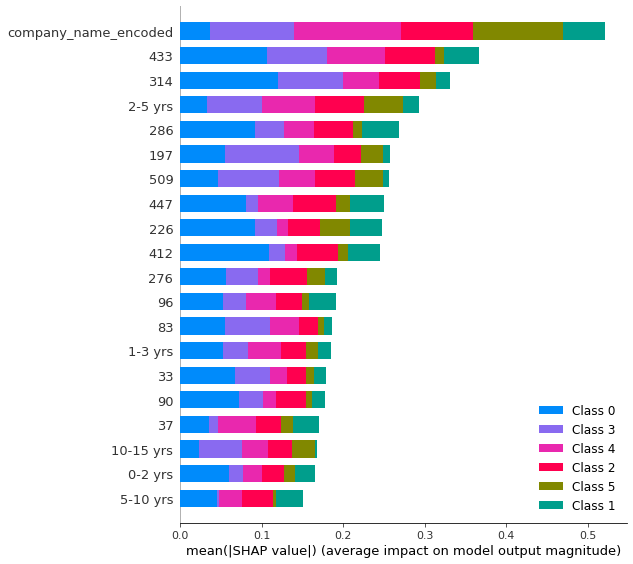

In [205]:
shap.summary_plot(shap_values, X)

### PREDICTING

In [261]:
prediction = stacked.predict(test_data_emb)

In [262]:
predicted = pd.DataFrame()

In [263]:
predicted['values'] = list(prediction)

In [264]:
predicted['values'] = predicted['values'].astype('str')

In [265]:
predicted['values'] = predicted['values'].replace('[^A-Za-z0-9]+','',regex=True)

In [266]:
predicted['values'] = predicted['values'].astype('int')

In [267]:
predicted['salary'] = le.inverse_transform(predicted['values'])

In [268]:
predicted

,values,salary
0,2,15to25
1,0,0to3
2,5,6to10
3,0,0to3
4,0,0to3
...,...,...
6596,5,6to10
6597,5,6to10
6598,2,15to25
6599,2,15to25


In [269]:
predicted.drop(columns=['values']).to_csv('prediction.csv',index=False)